In [2]:
# Load the Drive helper and mount
from google.colab import drive

# This will prompt for authorization.
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [3]:
!ls

drive  sample_data


In [4]:
cd /content/drive/My Drive

/content/drive/My Drive


In [5]:
!pwd

/content/drive/My Drive


In [6]:
!ls

autoencoder8.h5		   mobile_regress_7.h5
Expore_batched_data.ipynb  phaseOne_Autoencoder.ipynb
hdf5			   phaseThree_joint_shared.ipynb
joint_model_2.h5	   phaseTwo_generateEmbeddings_better.ipynb
mobile_regress_5.h5	   phaseTwo_ImageNet_mobile_8.ipynb


In [0]:
!pip install -q keras

In [8]:
import tensorflow as tf
tf.test.gpu_device_name()

'/device:GPU:0'

In [9]:
from tensorflow.python.client import device_lib
device_lib.list_local_devices()

[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 5260769408416702156, name: "/device:XLA_CPU:0"
 device_type: "XLA_CPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 12240392880468941515
 physical_device_desc: "device: XLA_CPU device", name: "/device:XLA_GPU:0"
 device_type: "XLA_GPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 4712678403118168616
 physical_device_desc: "device: XLA_GPU device", name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 11281553818
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 17910469324206833070
 physical_device_desc: "device: 0, name: Tesla K80, pci bus id: 0000:00:04.0, compute capability: 3.7"]

In [0]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

In [11]:
import numpy as np
import pandas as pd


from keras.models import Sequential, Model, load_model
from keras.layers.core import Dense, Activation, Flatten
from keras.layers.embeddings import Embedding
from keras.layers.recurrent import LSTM
from keras.layers import Conv3D, Conv3DTranspose, Conv2D, Conv1D, MaxPooling1D, MaxPooling2D, Input, BatchNormalization, Dropout, Lambda, Bidirectional
from keras.layers import CuDNNLSTM, Reshape, PReLU, ZeroPadding2D, average
from keras.layers.merge import concatenate
from keras.optimizers import RMSprop, Adam, SGD
from keras.models import load_model
from keras.callbacks import Callback
from keras.utils import plot_model

from keras.preprocessing import image
import keras.backend as K

import matplotlib.pyplot as plt

import time 
import tensorflow as tf
from sklearn import metrics
import pickle
import os
import scipy.io as sio

import keras

import sklearn

Using TensorFlow backend.


In [0]:
import PIL

In [0]:
#from google.colab import files
#files.download("embeddings.npy")

In [0]:

np.random.seed(5)
tf.set_random_seed(5)

In [0]:

from keras.applications.nasnet import NASNetMobile, decode_predictions

In [0]:
import h5py

# Explore batched data

In [17]:
with h5py.File("/content/drive/My Drive/hdf5/batch_0.h5") as f:
  # original images in format (3, 227, 227)
  # set channel as last dimension, and slice images to size 224
  images = np.swapaxes(f['data'].value, 1, 3)[:, 1:225, 1:225, :] 
  images = np.swapaxes(images, 1, 2) 
  #voxels = np.swapaxes(f["label-voxel"].value, 1, 4)
  print(images.shape)

(198, 224, 224, 3)


In [21]:
# original pixel values in batch
print(images.max())
print(images.min())

print("range: ",images.max() + abs(images.min()))

150.99301147460938
-122.67891693115234
range:  273.6719284057617


In [0]:
nas_model = NASNetMobile(input_shape=None, include_top=True, weights='imagenet', input_tensor=None, pooling=None, classes=1000)

In [0]:
broj_slike = 2

1.0
0.0


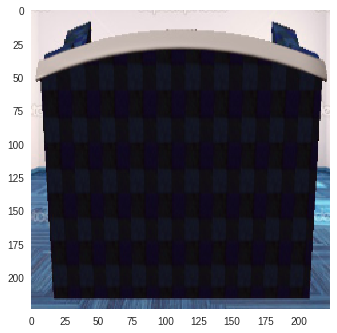

In [66]:
# transform images to pix values in range 0 to 1, for showing
image_show = images[broj_slike]+abs(images[broj_slike].min())
image_show = image_show/image_show.max()
print(image_show.max())
print(image_show.min())

plt.imshow(image_show)
plt.grid(False)

In [31]:
# scale images
max_min_mean = ( images.max() + images.min() ) / 2
images_scaled = (images - max_min_mean) / (images.max() - max_min_mean)  # scaling to range  -1 to 1

print(images_scaled.max())
print(images_scaled.min())

1.0
-1.0


In [30]:
# za prikaz slika
image_showing = images+abs(images.min())
image_showing = image_showing/image_showing.max()

print(image_showing.max())
print(image_showing.min())

1.0
0.0


In [32]:

print(images_scaled[broj_slike].max())
print(images_scaled[broj_slike].min())

predikt_class = nas_model.predict(images_scaled[broj_slike:broj_slike+1])
print(decode_predictions(predikt_class, top=5))


0.8422471894701214
-0.9553876340448857
[[('n04258138', 'solar_dish', 0.12059717), ('n04040759', 'radiator', 0.05694972), ('n03347037', 'fire_screen', 0.040470798), ('n03691459', 'loudspeaker', 0.018274346), ('n03673027', 'liner', 0.018191082)]]


/usr/local/lib/python3.6/dist-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


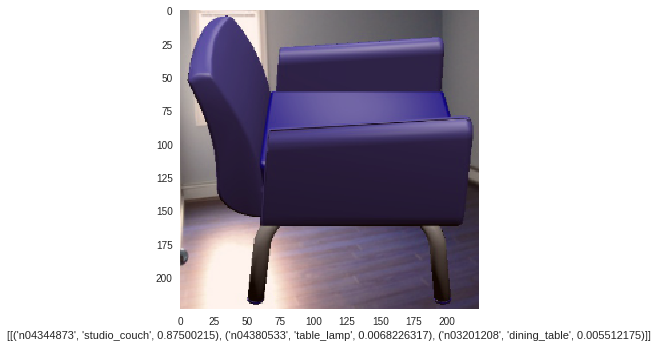

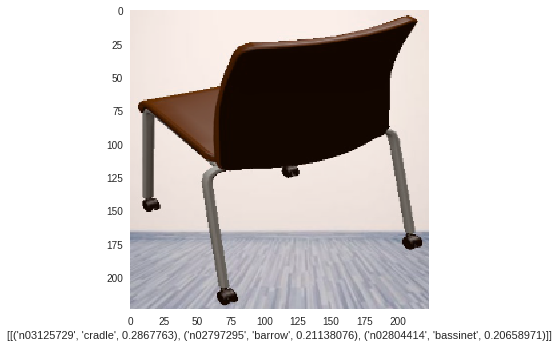

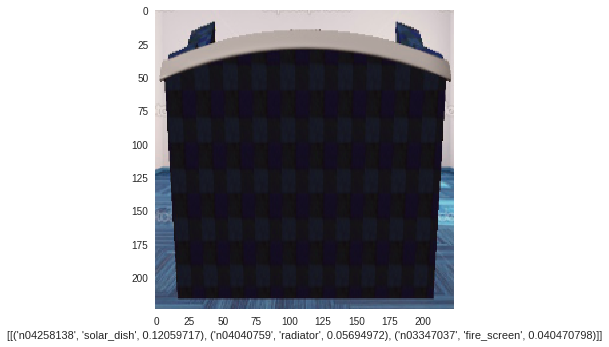

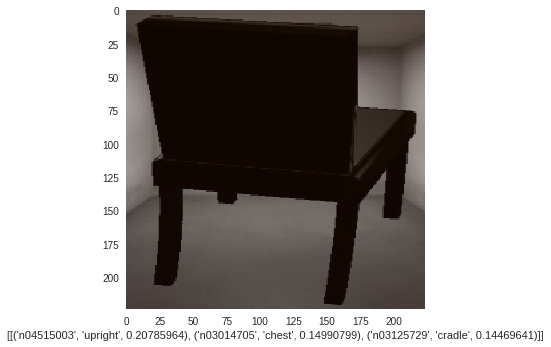

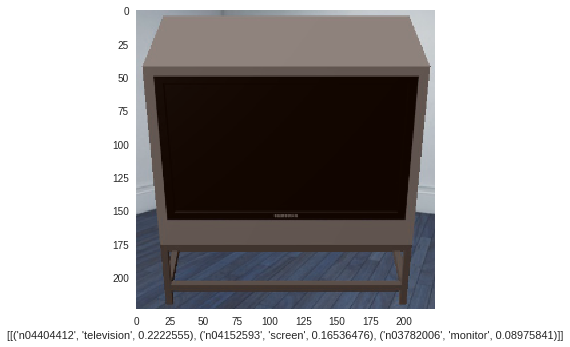

...

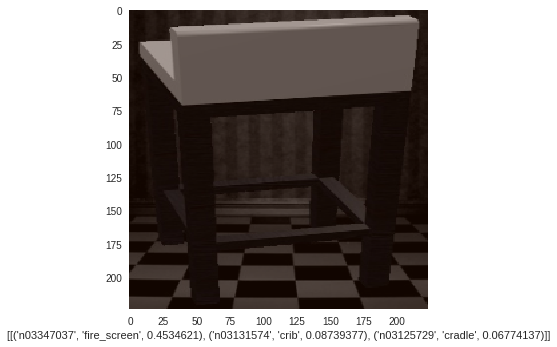

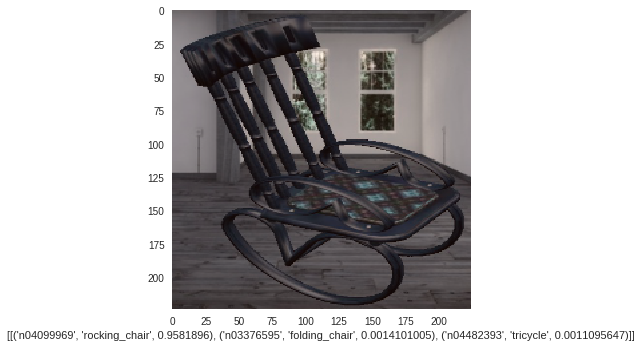

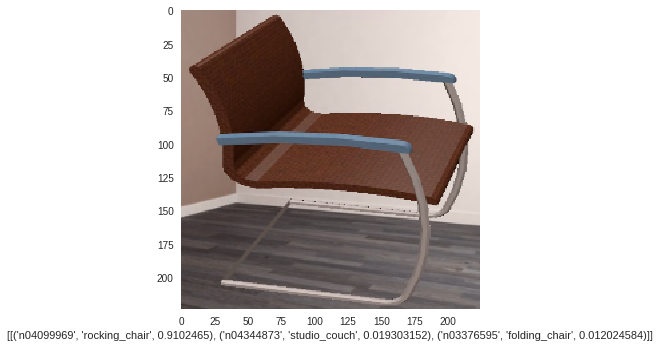

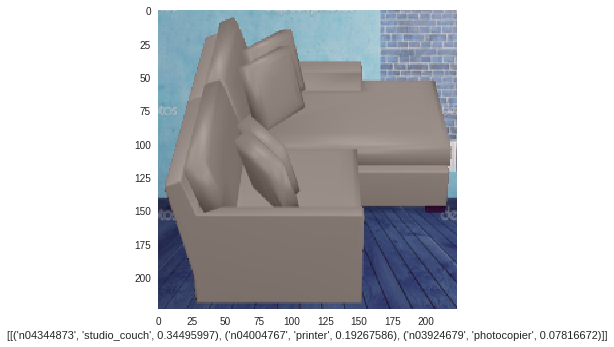

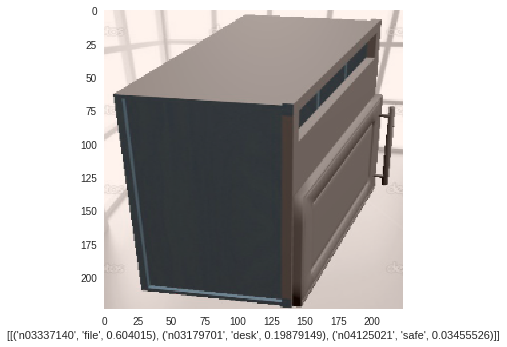

In [65]:
# all images and top3 prediction on xlabel

i = 0
#f = plt.figure(figsize = (100,100))
for image in image_showing:
  plt.figure()
  plt.imshow(image)
  plt.grid(False)
  plt.xlabel(decode_predictions(nas_model.predict(np.expand_dims(images_scaled[i], axis = 0)), top=3))
  i+= 1

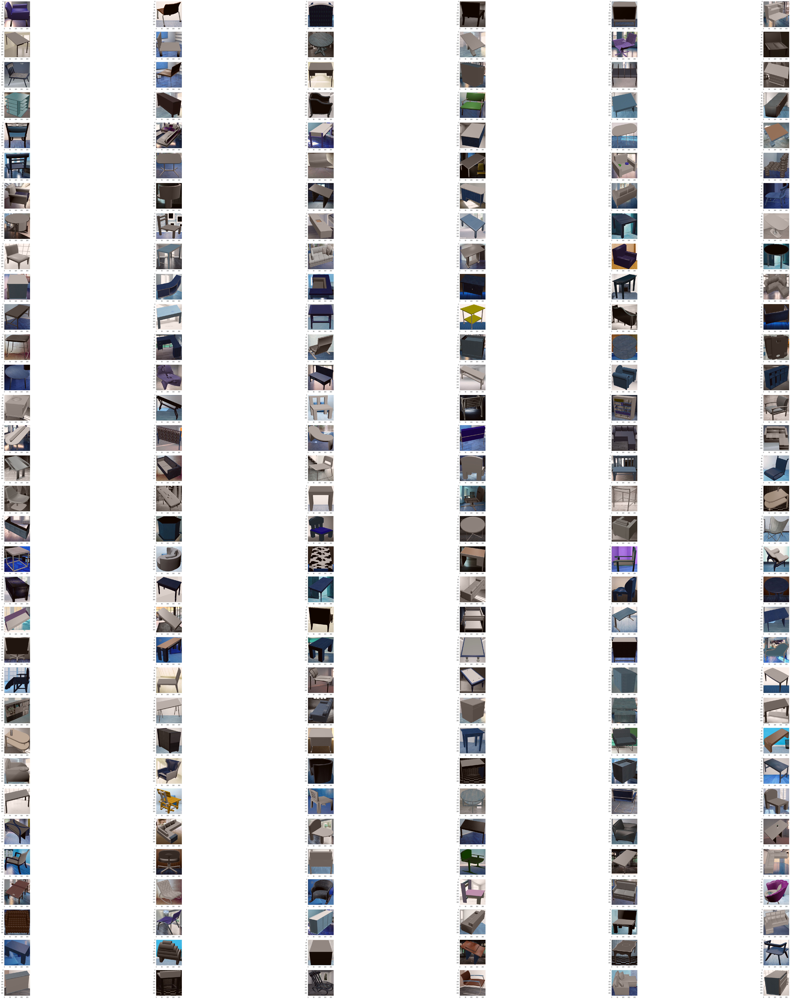

In [54]:
i = 1
f = plt.figure(figsize = (100,100))
for image in image_showing:
  
  ax = f.add_subplot(33, 6, i)
  i += 1
  ax.imshow(image)
  ax.grid(False)
f.tight_layout()


In [56]:
for image in images_scaled:
  predikt_class = nas_model.predict(np.expand_dims(image, axis = 0))
  print(decode_predictions(predikt_class, top=5))

[[('n04344873', 'studio_couch', 0.87500215), ('n04380533', 'table_lamp', 0.0068226317), ('n03201208', 'dining_table', 0.005512175), ('n04004767', 'printer', 0.0048828656), ('n02870880', 'bookcase', 0.0045837625)]]
[[('n03125729', 'cradle', 0.2867763), ('n02797295', 'barrow', 0.21138076), ('n02804414', 'bassinet', 0.20658971), ('n03376595', 'folding_chair', 0.060680468), ('n03201208', 'dining_table', 0.05708228)]]
[[('n04258138', 'solar_dish', 0.12059717), ('n04040759', 'radiator', 0.05694972), ('n03347037', 'fire_screen', 0.040470798), ('n03691459', 'loudspeaker', 0.018274346), ('n03673027', 'liner', 0.018191082)]]
[[('n04515003', 'upright', 0.20785964), ('n03014705', 'chest', 0.14990799), ('n03125729', 'cradle', 0.14469641), ('n03179701', 'desk', 0.0796185), ('n03201208', 'dining_table', 0.05291895)]]
[[('n04404412', 'television', 0.2222555), ('n04152593', 'screen', 0.16536476), ('n03782006', 'monitor', 0.08975841), ('n03376595', 'folding_chair', 0.038461186), ('n03290653', 'entertain

In [0]:
!kill

kill: usage: kill [-s sigspec | -n signum | -sigspec] pid | jobspec ... or kill -l [sigspec]


In [0]:
!kill -9 -1